In [27]:
from emlib import emlib
import logging
emlib.emlog.setLevel(logging.INFO)

In [28]:
def NPZUS_int(t,initial,dtinput,constants):

    P = initial[0]             # phytoplankton
    Z = initial[1]             # zooplankton
    N = initial[2]             # Nitrogen  
    ddin = dtinput.Val("ddin") #Concentration by day from WRTDS model 2 columns date and ddin Units are mg/L N
       
    Pg = constants.Val("Pg")    # max P growth =50
    e = constants.Val("e")      # Ingestion rate for zooplankton =0.75 
    Zm = constants.Val("Zm")    # Z mortality =0.6
    k = constants.Val("k")      # Half saturaion coefficient nitrogen = 0.3 
          
      
    P_dot = (N/(k+N))*P*(1.0-(P/Pg))-((P**2.0)/(1.0+P))*Z
    Z_dot = e*((P**2.0)/(1.0+P**2.0))*(Z-e)*(Z**Zm)
    N_dot = (N/(k+N))*P*(1.0-(P/Pg))+(1.0-e)*(P**2.0/(1.0+P**2.0))*(Z+ddin)
    

    return [P_dot,Z_dot,N_dot]

In [29]:
NPZUS = emlib.Model(NPZUS_int) #save the model

INFO -1104- New Model(6): NPZUS_int
INFO -1116- No algorithm supplied assuming vode/bfd O12 Nsteps3000 dt1


In [30]:
nutrients= emlib.TimeSeries(dirname="Data",filename="Guadalupe_input.csv") #loading in input timeseries data ddin 2013-2019
nutrients_alltime= emlib.TimeSeries(dirname="Data",filename="Guadalupe_inputall.csv")

chla_observation = emlib.Observation ("P", dirname="Data",filename= "US_Chl.csv")   #2/3 of data for calibration
zoop_observation = emlib.Observation ("Z", dirname="Data",filename= "US_Zoop.csv")  #2/3 of data for calibration
N_observation = emlib.Observation ("N", dirname="Data",filename= "US_N.csv") #2/3 of data for calibration

chla_validation = emlib.Observation ("P", dirname="Data",filename= "US_Chl_val.csv")   #2/3 of data for calibration
zoop_validation = emlib.Observation ("Z", dirname="Data",filename= "US_Zoop_val.csv")  #2/3 of data for calibration
N_validation = emlib.Observation ("N", dirname="Data",filename= "US_N_val.csv") #2/3 of data for calibration

NPZUScalibration = emlib.Calibration()  #all of our coefficients
NPZUScalibration.Add("Pg",val=50,min= 0.01, max= 90)
NPZUScalibration.Add("e",val=0.75,min= 0.01, max= 2.0)
NPZUScalibration.Add("Zm",val=0.6,min= 0.01, max= 3.0)
NPZUScalibration.Add("k",val=0.3,min= .01, max= 3.0)
NPZUScalibration.initial=[0.5,0.5,0.5]

legend = ["P", "Z", "DIN"]   #our graph legend



INFO -879- New TimeSeries instance: 11
INFO -879- New TimeSeries instance: 12
INFO -758- Read file DataUS_Chl.csv 9 Observations for value P
INFO -758- Read file DataUS_Zoop.csv 3 Observations for value Z
INFO -758- Read file DataUS_N.csv 9 Observations for value N
INFO -758- Read file DataUS_Chl_val.csv 5 Observations for value P
INFO -758- Read file DataUS_Zoop_val.csv 2 Observations for value Z
INFO -758- Read file DataUS_N_val.csv 5 Observations for value N
INFO -352- New Calibration instance: 6


In [ ]:
import copy
runs = 1000000

NPZUS.Integrate(NPZUScalibration.initial, Calibration=NPZUScalibration,TimeSeries= nutrients, dt=0.01) 
GF_chla = NPZUS.Validate(chla_observation)
GF_zoop = NPZUS.Validate(zoop_observation)
GF_N = NPZUS.Validate(N_observation)
avg_MSE = (GF_N.MSE + GF_zoop.MSE + GF_chla.MSE)/ 3
avg_RANGE = (GF_N.RANGE + GF_zoop.RANGE + GF_chla.RANGE) / 3

best = None
print ("Org. fitness:", GF_N.RANGE, GF_zoop.RANGE, GF_chla.MSE, avg_RANGE)

for i in range(runs):
    testingC = copy.deepcopy(NPZUScalibration)
    testingC.Randomize()
    NPZUS.Integrate(NPZUScalibration.initial, Calibration=testingC,TimeSeries= nutrients, dt=0.01) 
    GF_N_new = NPZUS.Validate(N_observation)
    GF_zoop_new = NPZUS.Validate(zoop_observation)
    GF_chla_new = NPZUS.Validate(chla_observation)
    avgRANGE_new = (GF_N_new.RANGE + GF_zoop_new.RANGE + GF_chla_new.RANGE) / 3
    avgMSE_new = (GF_N_new.MSE + GF_zoop_new.MSE + GF_chla_new.MSE) / 3
    print ("New. fitness:", GF_N_new.RANGE, GF_zoop_new.RANGE, GF_chla_new.RANGE, avgRANGE_new)
    
    if (GF_N_new.MSE  is 0) or (GF_zoop_new.MSE  is 0) or (GF_chla_new.MSE  is 0):
        print ("invalid...")
        continue
    if (GF_N_new.RANGE  is 0)  or (GF_chla_new.RANGE  is 0):  # zoop count it so small we cant strip by range =0
        print ("invalid...")
        continue
        
        
    if (avgRANGE_new >= avg_RANGE) and (avgMSE_new <= avg_MSE):
        best = testingC
        print("New Best Calibration:")
        best.Print()
        avg_RANGE = avgRANGE_new
        avg_MSE = avgMSE_new

if best:  #if we found a best calibration lets print it out
    NPZUS.Integrate(NPZUScalibration.initial, Calibration=best,TimeSeries= nutrients, dt=0.01)
    NPZUS.Validate(chla_observation, graph =True, legend=legend) 
    NPZUS.Validate(N_observation, graph =True, legend=legend) 
    NPZUS.Validate(zoop_observation, graph =True, legend=legend) 
    NPZUS.fit.Print()
    best.Print()
    
   

C:\Users\mrohal\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in double_scalars
  from ipykernel import kernelapp as app
C:\Users\mrohal\AppData\Local\Continuum\anaconda3\lib\site-packages\scipy\integrate\_ode.py:1009: UserWarning: vode: Repeated convergence failures. (Perhaps bad Jacobian supplied or wrong choice of MF or tolerances.)
  self.messages.get(istate, unexpected_istate_msg)))
C:\Users\mrohal\AppData\Local\Continuum\anaconda3\lib\site-packages\scipy\integrate\_ode.py:1009: UserWarning: vode: Illegal input detected. (See printed message.)
  self.messages.get(istate, unexpected_istate_msg)))


Org. fitness: 0 0 nan 0.0
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...


C:\Users\mrohal\AppData\Local\Continuum\anaconda3\lib\site-packages\scipy\integrate\_ode.py:1009: UserWarning: vode: Excess work done on this call. (Perhaps wrong MF.)
  self.messages.get(istate, unexpected_istate_msg)))
C:\Users\mrohal\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in double_scalars
  from ipykernel import kernelapp as app


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. 

C:\Users\mrohal\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\mrohal\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:16: RuntimeWarning: overflow encountered in double_scalars
  app.launch_new_instance()
C:\Users\mrohal\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:16: RuntimeWarning: invalid value encountered in double_scalars
  app.launch_new_instance()


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness:

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1

C:\Users\mrohal\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: divide by zero encountered in double_scalars
  
C:\Users\mrohal\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:16: RuntimeWarning: divide by zero encountered in double_scalars
  app.launch_new_instance()
C:\Users\mrohal\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in double_scalars
  


New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitnes

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitn

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
in

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
inv

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. f

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 44.4 22.2
New. fit

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. f

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.39999

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fi

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 44.4 22.2
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
inva

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
i

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fi

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
inva

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.399999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 11.1 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. f

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.39999999

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invali

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
inval

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
inv

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
N

New. fitness: 0 33.3 0 11.1
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...


New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid..

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 66.7 0 25.933333333333334
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness:

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
N

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...

New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
N

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
in

New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2

New. fitness: 33.3 0 55.6 29.633333333333336
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
i

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fit

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. f

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invali

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
inv

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
N

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.69999999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitnes

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitnes

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitn

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 55.6 25.933333333333334
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
N

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
inv

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
N

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.39999999999

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 66.7 0 29.633333333333336
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...


New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 66.7 0 29.633333333333336
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
Ne

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 33.3 22.2
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid..

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. f

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
inv

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
inva

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 33.3 0 44.4 25.899999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 33.3 14.799999999999999
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 66.7 29.633333333333336
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness:

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
inva

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
Ne

New. fitness: 33.3 0 22.2 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.

New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0

New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.699

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
N

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 0 44.4 25.899999999999995
New. fitnes

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 44.4 22.2
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 1

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.399999

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
i

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
Ne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 33.3 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.39999999999999

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.39999999999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fit

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
Ne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.69999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid..

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.7999999

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.399

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.7

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invali

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 44.4 22.2
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.39999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
inva

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
inv

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
inva

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fi

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness

New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.399999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
inva

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
N

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 33.3 0 11.1
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitnes

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.69

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitn

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995


New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 1

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitne

New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...


New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. 

New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 33.3 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
Ne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0


New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
Ne

New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid..

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 33.3 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 11.1

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
in

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fi

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 2

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.399999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitn

New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. 

New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitn

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitn

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 66.7 11.1 33.333333333333336
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
Ne

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness:

New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. f

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
inva

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
Ne

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid.

New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 

New. fitness: 22.2 0 44.4 22.2
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 44.4 25.899999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness:

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...

New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
inva

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitnes

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness:

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 

New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 66.7 0 25.933333333333334
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
i

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fi

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 11.1 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 44.4 22.2
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
Ne

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.39

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 33.3 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitnes

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...


New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 22.2 25.900000000000002
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
Ne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
inva

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.399999999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New.

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 11.1 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.39999999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitnes

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
inva

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New.

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 33.3 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.39999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid..

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 33.3 22.2 25.900000000000002
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 44.4 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New.

New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
inv

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
inval

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
inv

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
inv

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitn

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 44.4 25.899999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitn

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness:

New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. f

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
inv

New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.39999999999

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 44.4 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid.

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid..

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 33.3 0 44.4 25.899999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 22.2 25.900000000000002
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 33.3 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitn

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness:

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
Ne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
inv

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 44.4 25.899999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 66.7 29.633333333333336
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0


New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. f

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 33.3 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
inva

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitnes

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. 

New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 33.3 0 33.3 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fit

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.699

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.399999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitn

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid..

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitne

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.399999

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
inval

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.399999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fi

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 0 11.1 14.799999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. f

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 11.1 0 0 3.699999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
in

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.399999999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.39999

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
i

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2

New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness

New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.399999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995


New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
inva

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitnes

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
inv

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995


New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid..

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 22.2 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invali

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...

New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid.

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.39999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
inva

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fi

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 33.3 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fi

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fit

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness:

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
in

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.699999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
N

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invali

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness:

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. f

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fi

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
Ne

New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.39

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fi

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 33.3 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 66.7 0 25.933333333333334
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitne

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.39999

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 11.1 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
N

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
inva

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 44.4 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
N

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
inva

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
in

New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid..

New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
in

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fit

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitn

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 66.7 0 25.933333333333334
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
inval

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 33.3 14.799999999999999
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invali

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness:

New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitne

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness:

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 22.2 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.399999999

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fit

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 44.4 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.399999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
i

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
inv

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 22.2 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.699999999999999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0

New. fitness: 33.3 0 22.2 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 22.2 25.900000000000002
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 0 44.4 25.899999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 22.2 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitn

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 44.4 22.2
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 2

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.39999999999999

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
inva

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 66.7 29.633333333333336
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fit

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 0 33.3 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitn

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 11.1 0 11.1 7.399999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitnes

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitne

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
in

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.39999999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitn

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.69999

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness:

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 33.3 0 11.1
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invali

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 22.2 0 0 7.3999999999

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.39999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 22.2 25.9000000000

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.69999999

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New.

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fit

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 33.3 0 22.2 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.39999999999999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness:

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 66.7 0 25.933333333333334
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995


New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
inv

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitn

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 55.6 25.933333333333334
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 44.4 22.2
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitn

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.399999999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness:

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.39999999999999

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
inva

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 0 22.2 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitne

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 22.2 25.900000000000002
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0

New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.699999999999999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 33.3 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 1

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. f

New. fitness: 22.2 33.3 22.2 25.900000000000002
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 33.3 22.2 25.900000000000002
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitnes

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 66.7 0 25.933333333333334
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 22.2 25.900000000000002
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0

New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995


New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitne

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999

New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...

New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invali

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 66.7 11.1 33.333333333333336
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.399999999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
N

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 11.1 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitnes

New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New.

New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fi

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
N

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0

New. fitness: 33.3 0 44.4 25.899999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invali

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
inva

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
Ne

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitn

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 11.1 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
inva

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 44.4 25.89

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitnes

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fit

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
in

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2

invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
Ne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. f

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.399999999999999

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
inva

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.399

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
i

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid.

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
in

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fit

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
Ne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.699999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invali

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.699999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995


New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New.

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 22.2 25.900000000000002
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New.

New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 22.2 25.900000000000002
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.39999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 66.7 0 25.933333333333334
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 22.2 0 0 7.3999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fit

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.699999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997

New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0


New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
Ne

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
Ne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
inv

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.39999999999999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.69999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
inval

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 33.3 14.799999999999999
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid.

New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. f

New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
i

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 44.4 25.899999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
inval

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. f

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fi

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 44.4 25.899999999999995
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.699999999999999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0


New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fi

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 22.2 0 0 7.3999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fit

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.399999999999

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
inv

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 33.3 33.3 0 22.2
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
N

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness:

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0

New. fitness: 11.1 0 22.2 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitn

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
N

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invali

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
in

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
N

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 44.4 25.899999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 11.1 0 33.3 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 11.1 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 0 0 0 0.0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
inva

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 55.6 25.933333333333334
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 0 33.3 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
inval

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 1

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 66.7 29.633333333333336
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fit

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.39999999999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
inv

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitnes

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
inval

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.39999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.69999999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid..

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitnes

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...


New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
inva

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
inv

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.69

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.39999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 66.7 0 29.633333333333336
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. f

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 44.4 25.899999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invali

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 11

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fi

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitnes

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
in

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 33.3 14.799999999999999
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 11.1 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. f

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 22.2 25.900000000000002
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
inva

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
in

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 44.4 2

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
inv

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 66.7 0 25.933333333333334
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitn

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness

New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fit

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
inv

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitnes

New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid..

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 11.1 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
inva

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 

New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 1

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitne

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0


New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 11.1 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness:

New. fitness: 22.2 33.3 22.2 25.900000000000002
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 33.3 0 44.4 25.899999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
in

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitn

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 

New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invali

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
inv

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 0 44.4 25.899999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.399999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 11.1 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0


New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 44.4 25.899999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
inva

invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 11.1 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 66.7 0 29.633333333333336
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
N

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invali

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 33.3 0 14.79999999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
i

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid..

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
inval

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitne

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995


New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 2

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fi

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0


New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fit

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitnes

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitn

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitnes

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid.

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
in

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invali

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...


New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness:

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
Ne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fi

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
inval

New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
in

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 66.7 0 29.633333333333336
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 22.2 25.900000000000002
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fi

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 11.1 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.69999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
in

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 22.2 25.900000000000002
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 22.2 25.900000000000002
New. fitness: 11.1 33.3

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 33.3 0 0 11.1
invalid

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
N

New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 44.4 25.899999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
N

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.39

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitn

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
inv

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitnes

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 22.2 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid.

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 2

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999

New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New.

New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 22.2 25.900000000000002
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. f

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 44.4 25.899999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 22.2 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness:

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.399999999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fit

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
inva

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
inva

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
i

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fit

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid..

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fit

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitnes

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
N

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fit

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.699

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid.

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
i

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
N

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitnes

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...


New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitnes

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitne

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
in

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...


New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid

New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 22.2 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.699

New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
Ne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 33.3 18.5
New. fitness: 0 0 0 0.0
invalid

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
inv

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fit

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitnes

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitn

New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 11.1 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invali

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
inval

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.39999999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 11.1 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 55.6 25.9333333333

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
inva

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 33.3 0 44.4 25.899999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New.

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.39999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fi

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitn

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
Ne

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
inva

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
N

New. fitness: 11.1 0 22.2 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invali

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 66.7 0 29.633333333333336
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 0 44.4 25.899999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fit

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fit

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1


New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invali

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0

New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 33.3 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
N

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitne

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 22.2 25.900000000

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 33.3 0 33.3 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. f

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999

New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.69999

New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 44.4 25.899999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.399

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 22.2 25.900000000000002
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.39999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness:

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
inv

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.399

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 66.7 0 25.933333333333334
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.69999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0

New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. f

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. f

New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fi

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 11.1 0 0 3.699999999999999

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.39

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
inval

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitnes

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 

New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0


New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
inva

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 33.3 0 44.4 25.899999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.39999999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 33.3 33.3 0 22.2
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
in

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invali

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
inv

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
inv

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 1

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitnes

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 

New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid..

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
i

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitne

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fi

New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invali

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 11.1 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 22.2 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 33.3 22.2 25.900000000000002
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.399

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invali

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
N

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.69999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999

New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.69999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness:

New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitnes

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. f

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
inval

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New.

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
i

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997


New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.699999999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitnes

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.69999999

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid.

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.69999999999999

New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitn

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitn

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitnes

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitne

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
i

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 33.3 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.39999999

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fi

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid..

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.39999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0

invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitne

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
Ne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fi

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fi

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
in

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 44.4 25.899999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 44.4 25.899999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 33.3 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 44.4 22.2
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitnes

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.

New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. f

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0


New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0

New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fit

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invali

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
inva

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fit

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitnes

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
N

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 11.1 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
inva

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...


New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness

New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fit

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
N

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999

New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.69999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 33.3 0 33.3 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. 

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1

New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fi

New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid

invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitn

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fi

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
inv

New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 33.3 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.399999999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 22.2 25.900000000000002
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0

New. fitness: 22.2 0 33.3 18.5
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
in

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fi

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness

New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0


New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid..

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.39999999

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 33.3 0 44.4 25.899999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...


New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
inv

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 33.3 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.399999999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 33.3 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.39999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.69999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...


New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
Ne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 22.2 25.900000000000002
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid..

New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
Ne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
N

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitne

New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid..

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness:

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 11.1 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
inval

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. f

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. f

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 22.2 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 22.2 0 11.1 11.1
New.

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 11.1 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitnes

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitn

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
Ne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 33.3 22.2 25.900000000000002
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitnes

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
i

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 11.1 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.699

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0

New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
in

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness:

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 33.3 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
i

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 33.3 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness:

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invali

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 44.4 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fi

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
N

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 33.3 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
N

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 0 0 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
in

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fit

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11

New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 11.1 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
inv

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
N

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitnes

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.699

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid..

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid.

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. 

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 1

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 22.2 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...

New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999

New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 22.2 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
i

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness

New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.39999999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
in

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
inva

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999


New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997


New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid..

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.39

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.

New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid..

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 11.1 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitn

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 11.1 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness:

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invali

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...


New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
in

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
i

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitn

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
N

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 22.2 25.900

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 33.3 22.2 25.900000000000002
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.39

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 33.3 0 44.4 25.899999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 44.4 22.2
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid.

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
i

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 33.3 22.2 25.900000000000002
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
inv

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 44.4 25.899999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
Ne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.69999999999999

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 22.2 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0

New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 22.2 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 66.7 11.1 29.63333333333333
New. fitness: 0 0 0 0.0
invalid...
New. fitnes

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
N

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. 

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 0 14.7999999

New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.39

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0


New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 33.3 0 11.

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 22.2 25.900000000000002
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitne

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New.

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. f

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 11.1 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 33.3 

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitnes

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 11.1 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 33.3 11

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 33.3 0 11.1
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 0 11.1
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0


New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
N

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
i

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
Ne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitne

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.399999

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 2

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 0 18.5
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitn

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fit

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 33.3 22.2 25.900000000000002
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 33.3 0 11.1 14.799999999999999
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.39999999999

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitn

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.69999999999999

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 22.2 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness:

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.399

New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
N

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 0 14.799999999999999
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 22.2 14.799999999999999
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 

New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 33.3 11.1 22.2
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 33.3 22.2 25.900000000000002
New. 

New. fitness: 22.2 0 11.1 11.1
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0

New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 0 11.1 7.3999999999999995
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 11.1 11.1
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 11.1 33.3 11.1 18.5
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 11.1 0 0 3.6999999999999997
invalid...
New. fitness: 0 0 0 0.0
invalid.

New. fitness: 0 0 0 0.0
invalid...
New. fitness: 0 0 0 0.0
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...
New. fitness: 22.2 0 0 7.3999999999999995
invalid...


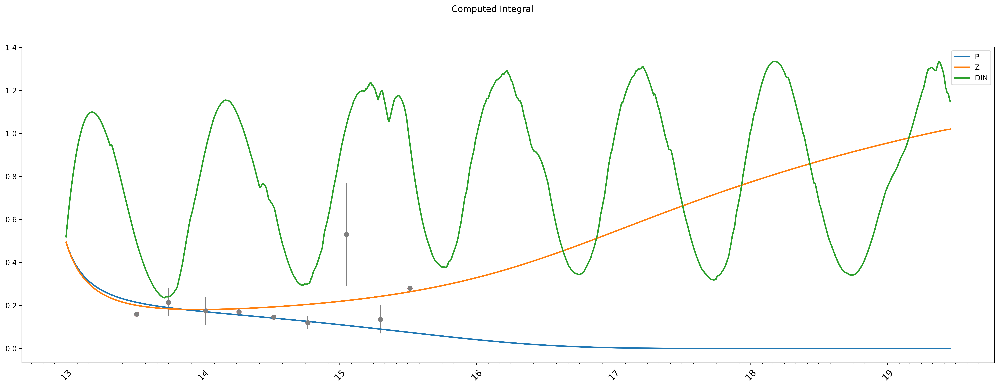

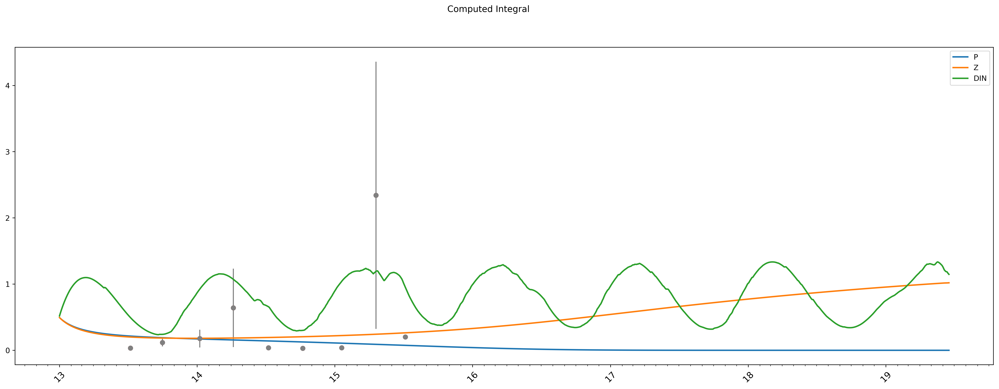

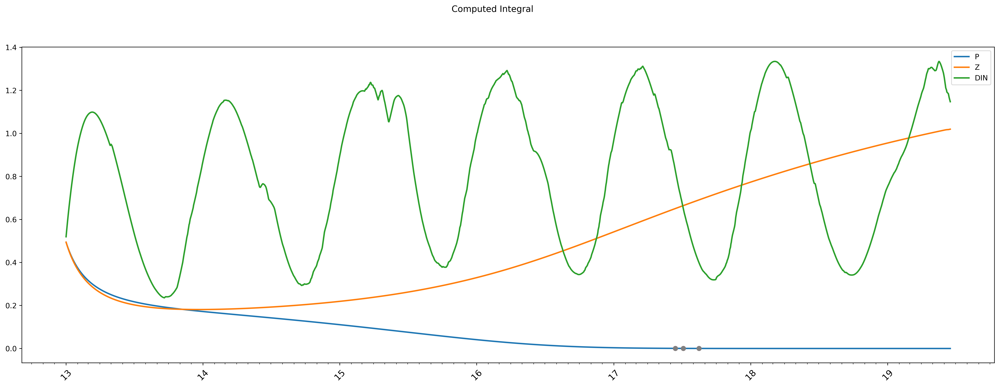

GFMODEL #3 Xtot:0.0 RMSD:0.0 RMSE:0.0 RANGE%33.3 MSER:0.0 WMSE:0.0
Label	Value	Min	Max	ISConst	Desc
i 	 0.4228493544794364 	 0.01 	 3.0 	 False 	 None
Pg 	 1.1409242572886165 	 0.01 	 3.0 	 False 	 None
e 	 0.03207237448638583 	 0.01 	 2.0 	 False 	 None
Zm 	 0.04724103887627344 	 0.01 	 3.0 	 False 	 None
Pm 	 0.5798595427238212 	 0.01 	 3.0 	 False 	 None
h 	 2.668703774051742 	 0.01 	 3.0 	 False 	 None
s 	 1.8828288948155705 	 0.01 	 3.0 	 False 	 None


In [8]:
if best:  #if we found a best calibration lets print it out
    NPZUS.Integrate(NPZUScalibration.initial, Calibration=best,TimeSeries= nutrients, dt=0.01)
    NPZUS.Validate(chla_observation, graph =True, legend=legend) 
    NPZUS.Validate(N_observation, graph =True, legend=legend) 
    NPZUS.Validate(zoop_observation, graph =True, legend=legend) 
    NPZUS.fit.Print()
    best.Print()

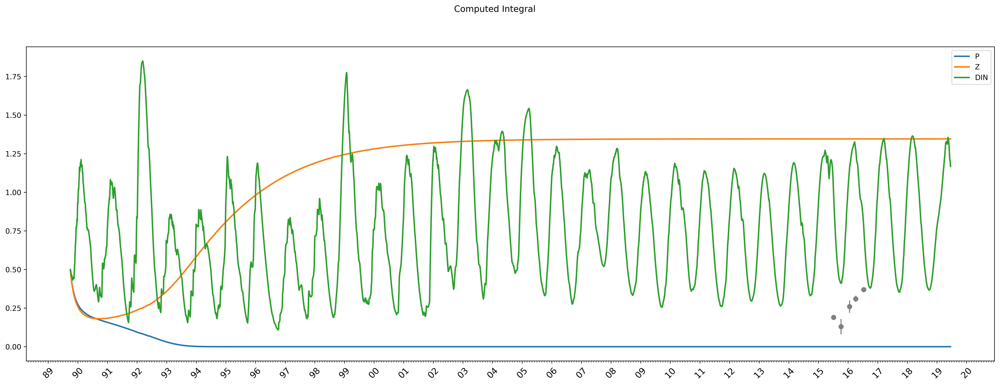

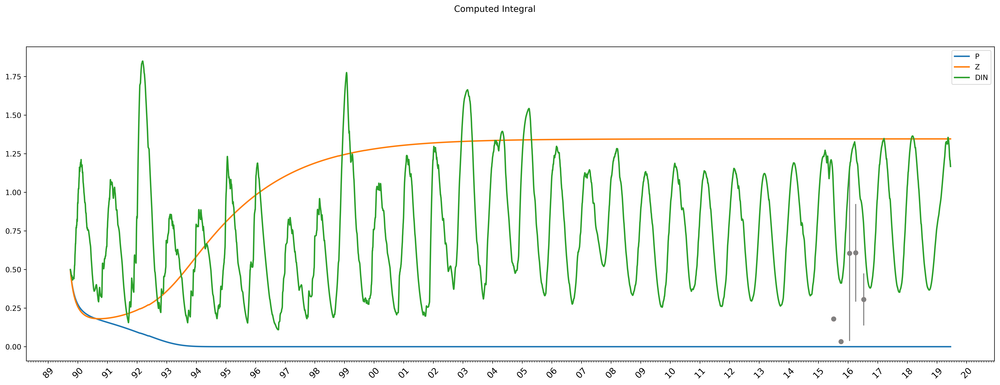

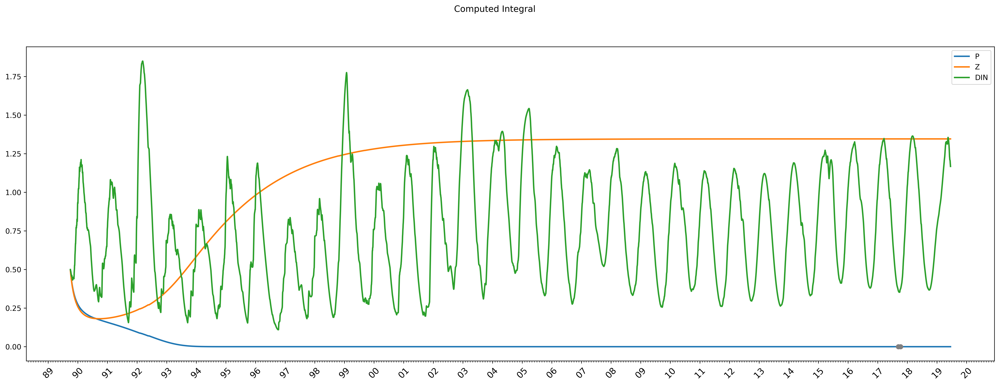

GFMODEL #2 Xtot:0.0 RMSD:4.8 RMSE:0.0 RANGE%0 MSER:0.0 WMSE:0.0
Label	Value	Min	Max	ISConst	Desc
i 	 0.4228493544794364 	 0.01 	 3.0 	 False 	 None
Pg 	 1.1409242572886165 	 0.01 	 3.0 	 False 	 None
e 	 0.03207237448638583 	 0.01 	 2.0 	 False 	 None
Zm 	 0.04724103887627344 	 0.01 	 3.0 	 False 	 None
Pm 	 0.5798595427238212 	 0.01 	 3.0 	 False 	 None
h 	 2.668703774051742 	 0.01 	 3.0 	 False 	 None
s 	 1.8828288948155705 	 0.01 	 3.0 	 False 	 None


In [10]:
if best:  #if we found a best calibration lets print it out
    NPZUS.Integrate(NPZUScalibration.initial, Calibration=best,TimeSeries= nutrients_alltime, dt=0.01)
    NPZUS.Validate(chla_validation, graph =True, legend=legend) 
    NPZUS.Validate(N_validation, graph =True, legend=legend) 
    NPZUS.Validate(zoop_validation, graph =True, legend=legend) 
    NPZUS.fit.Print()
    best.Print()